<a href="https://colab.research.google.com/github/oceam/agri-image/blob/main/codes/PointCloudProcess.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Point Cloud Process  
Haozhou Wang & Wei Guo  
2022.08.25->2023.08.31

# Environment setup

First, download the necessary assets used in this Lesson

In [1]:
# assets for this course
!gdown https://drive.google.com/drive/folders/1EnhmkwsNotmeqKvKjL4OlvP38MLhU3BP?usp=sharing -O ./assets --folder

# easypcc.js for data labelling
!gdown https://drive.google.com/drive/folders/1tjbNPyo6h6tkTUA9yAQhVueMQAR_o8x5?usp=sharing -O /usr/local/share/jupyter/nbextensions/google.colab/ --folder

Retrieving folder list
Processing file 1Fowamoc0V9GKvAUVsGRLErSFT8IWDOuv demo_maize.ply
Processing file 1YzXhkVXZrvQDNjEcnec8wbU4G3J_G88u IMG_2637.JPG
Retrieving folder 1CylI2SSmPxcnM_7m-MkhPNYE8KQbCfBQ imgs
Processing file 1_GnmkZfdMLJGBWy3HgfihH5VSiKUv3Cw annotate.png
Processing file 1tGH85g7U0UqwNu4XR9GzohIDvCaTAR3e download.png
Processing file 1UVscGa8MZJ4y7Q2yMPkwNrTJVzE8cMpg dragdrop.png
Processing file 1caa2VZO2Uf8B23pBtMlit3KqkgTqPtc4 paper_fig.png
Processing file 15vIh5U_xMWTRFX7X1tPoVuG-KV5eGe_E upload.png
Processing file 1-19z1_qWttGJMhcFYDy_ZSgo3QjpuSoM paper.png
Processing file 1cetLQfDtiQGEg6vFuhNskvQy3BjwRp-x trainData_2classes.csv
Retrieving folder list completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1Fowamoc0V9GKvAUVsGRLErSFT8IWDOuv
To: /content/assets/demo_maize.ply
100% 8.00M/8.00M [00:00<00:00, 25.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1YzXhkVXZrvQDNjEcnec8wbU4G3J_G

## Then install the necessary librarys for this lesson

**Please ignore the follow error if it happens**

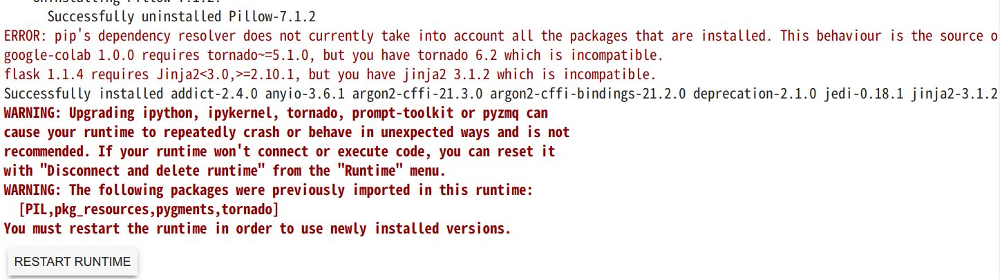


In [2]:
!pip install scikit-learn open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 420.5/420.5 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 8.1 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1
  Attempting uninstall: nbformat
    Found existing installation: nbformat 5.9.2
    Uninstalling nbformat-5.9.2:
      Successfully uninstalled nbforma

In [3]:
import open3d as o3d
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from copy import deepcopy

import skimage.io
import skimage.color
from skimage.filters import threshold_otsu
from skimage import morphology

import time
import sys
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

class Course:

    def __init__(self):
        pass

    ##################
    # 3 index values #
    ##################

    @staticmethod
    def ExG(img_np):
        img = img_np.astype(np.float32)

        if len(img.shape)==3:
            R = img[:, :, 0]
            G = img[:, :, 1]
            B = img[:, :, 2]
        else:
            R = img[:, 0]
            G = img[:, 1]
            B = img[:, 2]

        return 2 * G - R - B

    @staticmethod
    def ExR(img_np):
        img = img_np.astype(np.float32)

        if len(img.shape)==3:
            R = img[:, :, 0]
            G = img[:, :, 1]
            B = img[:, :, 2]
        else:
            R = img[:, 0]
            G = img[:, 1]
            B = img[:, 2]

        return 1.4 * R - G

    @staticmethod
    def NDI(img_np):
        img = img_np.astype(np.float32)

        if len(img.shape)==3:
            R = img[:, :, 0]
            G = img[:, :, 1]
            B = img[:, :, 2]
        else:
            R = img[:, 0]
            G = img[:, 1]
            B = img[:, 2]

        return (G - R) / (G + R + 0.0000000001)  # solve G=0 and R=0


    #########################
    # Otsu Threshold method #
    #########################
    @staticmethod
    def otsu(image):
        thresh = threshold_otsu(image)
        return image > thresh

    ######################
    # Calculate coverage #
    ######################
    @staticmethod
    def coverage(binary_img):
        h, w = binary_img.shape
        total = h * w

        true_num = np.sum(binary_img==True)

        return true_num / total

    @staticmethod
    def plant_index_otsu(img_list, figsize=None, dpi=300):
        img_num = len(img_list)
        if figsize is None:
            figsize = (4*img_num, 9)
        fig, ax = plt.subplots(3, img_num, figsize=figsize, dpi=300)

        if img_num == 1:
            ax = ax.reshape(3, 1)

        for i, test_img in enumerate(img_list):
            exg1 = course.ExG(test_img)
            exr1 = course.ExR(test_img)

            ex_GR1 = exg1 - exr1

            exg1_otsu = course.otsu(exg1)

            binary_GR1 = ex_GR1 > 0


            ax[0,i].set_title(f"Image {i+1}")

            ax[0,i].imshow(test_img)
            ax[0,i].set_xticks([])
            ax[0,i].set_yticks([])
            ax[0,i].set_xticklabels([])
            ax[0,i].set_yticklabels([])

            ax[1,i].set_title(f"{round(course.coverage(exg1_otsu)*100, 2)}%")
            ax[1,i].imshow(exg1_otsu, cmap="gray")
            ax[1,i].set_xticks([])
            ax[1,i].set_yticks([])
            ax[1,i].set_xticklabels([])
            ax[1,i].set_yticklabels([])
            ax[1,i].set_xlabel(f"ExG + Otsu")

            ax[2,i].set_title(f"{round(course.coverage(binary_GR1)*100, 2)}%")
            ax[2,i].imshow(binary_GR1, cmap="gray")
            ax[2,i].set_xlabel(f"ExG-ExR>0")
            ax[2,i].set_xticks([])
            ax[2,i].set_yticks([])
            ax[2,i].set_xticklabels([])
            ax[2,i].set_yticklabels([])

        plt.show()


    ########################
    # Supervised ML by CSV #
    ########################
    @staticmethod
    def expand_colorspace(img):
        # img is the ndarray from io.imread()
        if len(img.shape) == 3:  # input is image with h, w
            (h, w, dimen) = img.shape

            if dimen == 4: # exist alpha layer (RGBA)
                img = img[:,:, 0:3]
                dimen = 3

            rgb = img.reshape(h * w, dimen)
            lab = skimage.color.rgb2lab(img).reshape(h * w, dimen)
            hsv = skimage.color.rgb2hsv(img).reshape(h * w, dimen)
        elif len(img.shape) == 2: # input is point cloud color
            rgb = img
            lab = skimage.color.rgb2lab(img)
            hsv = skimage.color.rgb2hsv(img)
        else:
            raise ValueError(f"The shape {img.shape} does not fit (m,3) or (m,n,3)")

        exp_img = np.concatenate((rgb, lab, hsv), axis=1)

        return exp_img


    # def training_data_generate(img_list, kind_list):
    #     # example：
    #     # img_list = [io.imread(), io.imread(), io.imread()], element is ndarray
    #     # king_list = [0, 1, 2]
    #     train_data = np.empty((0, 9))
    #     train_kind = np.empty((0,))
    #     for img, kind in zip(img_list, kind_list):
    #         (h, w, dimen) = img.shape
    #         exp_img = expand_colorspace(img)

    #         if dimen == 4:
    #             img_reshape = img.reshape(h * w, dimen)
    #             train_index = np.nonzero(img_reshape[:, 3])  # the index of alpha layer not zero pixels
    #             exp_img = exp_img[train_index]  # pick the pixels that not background

    #         print(f"|--- Convert kind [{kind}] to training data, converted shape is {str(exp_img.shape)}")
    #         kinds = np.array([kind] * exp_img.shape[0])

    #         # merge each train_data and kind
    #         train_data = np.vstack((train_data, exp_img))
    #         train_kind = np.hstack((train_kind, kinds))

    #     return train_data, train_kind

    @staticmethod
    def training_data_from_easypcc_csv(csv_path, crop_name='Crop'):
        csv_data = pd.read_csv(csv_path)
        px_num = len(csv_data)

        # convert R G B vertical list to skimage.color.pixels
        csv_rgb = np.stack([csv_data[['R']], csv_data[['G']], csv_data[['B']]], axis=2)
        # convert in python way, incase JS not get same results
        lab = skimage.color.rgb2lab(csv_rgb).reshape(px_num, 3)
        hsv = skimage.color.rgb2hsv(csv_rgb).reshape(px_num, 3)
        # merge to list
        train_data = np.concatenate((csv_data[['R', 'G', 'B']], lab, hsv), axis=1)

        train_kind = np.zeros((px_num, 1))
        train_kind[csv_data['Class'] == crop_name, :] = 1

        return train_data, train_kind

    @staticmethod
    def train_model(train_data, train_kind, classifier="CART"):
        # classifier = ["CART", "SVM", "RF"]
        t0 = time.time()
        if classifier == "CART":
            clf = DecisionTreeClassifier(max_depth=20)
        elif classifier == "SVM":
            clf = LinearSVC()
        elif classifier == "RF":
            clf = RandomForestClassifier()
        elif classifier == "GDBT":
            clf = GradientBoostingClassifier()

        clf = clf.fit(train_data, train_kind)
        t1 = time.time()

        print(f'|-- Training model time cost={int(t1-t0)}s')
        return clf

    def predict_model(self, clf_img, model):
        exp_clf_img = self.expand_colorspace(clf_img)

        if len(clf_img.shape) == 3:  # image color
            (h, w, dimen) = clf_img.shape
            pred_result = model.predict(exp_clf_img).reshape(h, w)
        elif len(clf_img.shape) == 2:  # point cloud color
            pred_result = model.predict(exp_clf_img)
        else:
            raise ValueError(f"The shape {clf_img.shape} does not fit (m,3) or (m,n,3)")

        return pred_result

    def apply_model(self, clf_img, model):
        t0 = time.time()
        if len(clf_img.shape) == 3:  # image color
            (h, w, dimen) = clf_img.shape
            num = h * w
        elif len(clf_img.shape) == 2:  # point cloud color
            num, dimen = clf_img.shape
            h = num
        else:
            raise ValueError(f"The shape {clf_img.shape} does not fit (m,3) or (m,n,3)")

        if num >= 1600 * 1600:  # slice picture to save RAM
            slice_num = np.ceil(num / (1600 * 1600)).astype(np.int32)
            break_points = np.linspace(0, h, num=slice_num).astype(np.int32)
            line_st = break_points[:-1]
            line_ed = break_points[1:]
        else:
            line_st = [0]
            line_ed = [h]

        if len(clf_img.shape) == 3:
            pred_result = np.empty((0, w))
            i = 0
            for st, ed in zip(line_st, line_ed):
                clf_result = self.predict_model(clf_img[st:ed, :], model)
                pred_result = np.vstack((pred_result, clf_result))

                # progress bar
                percent = round((i+1) / len(line_st) * 100, 2)
                print('\r|' + '='*round(percent/2) + '>'+ ' '*round(50-percent/2) + '|' + str(percent) + '%', end="")
                i += 1

        if len(clf_img.shape) == 2:
            pred_result = np.empty(0)
            i = 0
            for st, ed in zip(line_st, line_ed):
                clf_result = self.predict_model(clf_img[st:ed, :], model)
                pred_result = np.hstack((pred_result, clf_result))

                # progress bar
                percent = round((i+1) / len(line_st) * 100, 2)
                print('\r|' + '='*round(percent/2) + '>'+ ' '*round(50-percent/2) + '|' + str(percent) + '%', end="")
                i += 1

        t1 = time.time()
        print(f'| Cost={int(t1-t0)}s')
        return pred_result

    @staticmethod
    def save_result(pred_result, img_save_name, color_list):
        color_list = np.array(color_list)/255
        cmap_cf = ListedColormap(color_list, name='colorfriendly')
        plt.imsave(img_save_name, pred_result, cmap=cmap_cf)

    @staticmethod
    def denoise(image, min_obj_size=100, area_thresh=25):
        cleaned1 = morphology.remove_small_objects(image==1, min_size=min_obj_size)
        cleaned1 = morphology.remove_small_holes(cleaned1, area_threshold=area_thresh)

        return cleaned1

    ###############
    # SML wrapper #
    ###############
    def supervise_machine_learning(self, uav_image, uav_train, denoise="default", save=None):
        test1 = skimage.io.imread(uav_image)
        train_data, train_kind = self.training_data_from_easypcc_csv(uav_train)
        model = self.train_model(train_data, train_kind, classifier="CART")
        result = self.apply_model(test1, model)
        if denoise == "default":
            result_clean = self.denoise(result)
        else:
            result_clean = self.denoise(result, denoise[0], denoise[1])

        fig, ax = plt.subplots(1, 3, figsize=(6,9), dpi=300)
        ax[0].imshow(test1)
        ax[0].set_xticks([])
        ax[0].set_yticks([])
        ax[0].set_xticklabels([])
        ax[0].set_yticklabels([])
        ax[0].set_xlabel("Original Image")

        ax[1].set_title(f"{round(self.coverage(result)*100, 2)}%")
        ax[1].imshow(result, cmap="gray")
        ax[1].set_xticks([])
        ax[1].set_yticks([])
        ax[1].set_xticklabels([])
        ax[1].set_yticklabels([])
        ax[1].set_xlabel("Classified by ML")

        ax[2].set_title(f"{round(self.coverage(result_clean)*100, 2)}%")
        ax[2].imshow(result_clean, cmap="gray")
        ax[2].set_xticks([])
        ax[2].set_yticks([])
        ax[2].set_xticklabels([])
        ax[2].set_yticklabels([])
        ax[2].set_xlabel("Denoised")
        if save is not None:
            os.makedirs(save, exist_ok=True)
            plt.tight_layout()
            plt.savefig(f"{save}/result_{uav_image.split('/')[-1]}")
            plt.close()
        else:
            plt.show()

        return round(self.coverage(result)*100, 2), round(self.coverage(result_clean)*100, 2)

    @staticmethod
    def draw_geometries(geometries):
        graph_objects = []

        for geometry in geometries:
            try:
                geometry_type = geometry.get_geometry_type()
            except AttributeError:
                geometry_type = type(geometry)

            if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
                points = np.asarray(geometry.points)
                colors = None
                if geometry.has_colors():
                    colors = np.asarray(geometry.colors)
                elif geometry.has_normals():
                    colors = (0.5, 0.5, 0.5) + np.asarray(geometry.normals) * 0.5
                else:
                    geometry.paint_uniform_color((1.0, 0.0, 0.0))
                    colors = np.asarray(geometry.colors)

                scatter_3d = go.Scatter3d(x=points[:,0], y=points[:,1], z=points[:,2], mode='markers', marker=dict(size=1, color=colors))
                graph_objects.append(scatter_3d)

            if geometry_type == o3d.geometry.Geometry.Type.TriangleMesh:
                triangles = np.asarray(geometry.triangles)
                vertices = np.asarray(geometry.vertices)
                colors = None
                if geometry.has_triangle_normals():
                    colors = (0.5, 0.5, 0.5) + np.asarray(geometry.triangle_normals) * 0.5
                    colors = tuple(map(tuple, colors))
                else:
                    colors = (1.0, 0.0, 0.0)

                mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
                graph_objects.append(mesh_3d)

            if geometry_type == o3d.visualization.SelectionPolygonVolume:
                bp = np.asarray(bbox.bounding_polygon)
                xmin = bp[0,0]
                xmax = bp[2,0]
                ymin = bp[0,1]
                ymax = bp[1,1]
                zmin = bbox.axis_min
                zmax = bbox.axis_max

                mesh_3d = go.Mesh3d(
                    x = [xmin, xmin, xmax, xmax, xmin, xmin, xmax, xmax],
                    y = [ymin, ymax, ymax, ymin, ymin, ymax, ymax, ymin],
                    z = [zmin, zmin, zmin, zmin, zmax, zmax, zmax, zmax],

                    i = [7, 0, 0, 0, 4, 4, 6, 6, 4, 0, 3, 2],
                    j = [3, 4, 1, 2, 5, 6, 5, 2, 0, 1, 6, 3],
                    k = [0, 7, 2, 3, 6, 7, 1, 1, 5, 5, 7, 6],

                    opacity=0.6,
                    color='#DC143C',
                    flatshading = True
                )
                graph_objects.append(mesh_3d)

        fig = go.Figure(
            data=graph_objects,
            layout=dict(
                scene=dict(
                    xaxis=dict(visible=True),
                    yaxis=dict(visible=True),
                    zaxis=dict(visible=True)
                )
            )
        )
        fig.update_layout(
            scene_aspectmode='data'
            #scene_aspectratio=dict(x=1, y=1, z=1)
            )
        fig.show()

course = Course()

# Background

Remember that the point cloud data is build by a techenique called "structure-from-motion (sfm) and multi-view stereo (mvs)"

An overview provided by MATLAB is here: https://www.mathworks.com/help/vision/ug/structure-from-motion.html

---

A Point cloud Object will be stored that contains the following PLY or PCD fields:

* `Location property`: stores the x, y, and z values.
* `Color property`: stores the red, green, and blue values.
* `Normal property` stores the normal vectors for each point.
* `Intensity property`: stores the grayscale intensity for each point.

We use PLY Format, also known as the Stanford Triangle Format, defines a flexible and systematic scheme for storing 3D data. The ASCII header specifies what data is in the file by defining "elements" each with a set of "properties."

Many PLY files only have vertex and face data, however, it is possible to also include other data such as color information, vertex normals, or application-specific properties.    

<img src="https://www.dropbox.com/s/vtew9zjsdwgyk34/ply_file.png?dl=1" alt="ply" />


# Read and view point cloud

In [4]:
pcd = o3d.io.read_point_cloud("assets/demo_maize.ply")

Then check the points number

In [5]:
np.array(pcd.points).shape

(296104, 3)

Check xyz values

In [6]:
np.array(pcd.points)

array([[1.49200201, 0.002935  , 0.49619699],
       [1.49331999, 0.002189  , 0.49627799],
       [1.49184406, 0.003671  , 0.49679199],
       ...,
       [1.92652297, 0.67269301, 0.94403601],
       [1.92959404, 0.67351598, 0.94180501],
       [1.92969501, 0.67595601, 0.94119298]])

In [7]:
# visualize original points will crash colab, so here downsample to 30k points
pcd_down = pcd.uniform_down_sample(10)
course.draw_geometries([pcd_down])

Lets observe the 3D first (Rotate it) !

Please check your point cloud and the range of the corrdinate system

To understand the corrdinate system, [Read the documentation here](https://www.mathworks.com/help/vision/gs/coordinate-systems.html)


# Extracting Maize

## Trial 1: By regular geometry position

Now we can define a ROI (Region of Interest, here means "maize") in the point cloud

For example, we can define a bounding box as the ROI:

In [8]:
xmin, xmax = 1.4, 1.8
ymin, ymax = 0.2, 0.4
zmin, zmax = 0.3, 1.2

create and visualize the bounding box

In [9]:
bbox = o3d.visualization.SelectionPolygonVolume()
bbox.orthogonal_axis = "Z"
bbox.bounding_polygon = o3d.utility.Vector3dVector(
    [[xmin, ymin, 0],
     [xmin, ymax, 0],
     [xmax, ymax, 0],
     [xmax, ymin, 0],
     [xmin, ymin, 0]])
bbox.axis_max = zmax
bbox.axis_min = zmin

In [10]:
course.draw_geometries([pcd_down, bbox])

Show the results of crop

In [11]:
pcd_bbox_crop = bbox.crop_point_cloud(pcd)

In [12]:
# down sample to visualise
pcd_bbox_crop_down = pcd_bbox_crop.uniform_down_sample(3)

In [13]:
course.draw_geometries([pcd_bbox_crop_down])

And check in whole model:

In [14]:
pcd_points = np.array(pcd.points)

in_bbox_idx = np.where(
    (xmin <= pcd_points[:,0]) & (pcd_points[:,0] <= xmax) & \
    (ymin <= pcd_points[:,1]) & (pcd_points[:,1] <= ymax) & \
    (zmin <= pcd_points[:,2]) & (pcd_points[:,2] <= zmax)
)[0]

In [15]:
temp_pcd = deepcopy(pcd)

t_color = np.asarray(temp_pcd.colors)

t_color[:, :] = [0, 0, 1]
t_color[in_bbox_idx,:] = [1, 0, 0]

temp_pcd.colors = o3d.utility.Vector3dVector(t_color)

temp_pcd_down = temp_pcd.uniform_down_sample(10)
course.draw_geometries([temp_pcd_down])

Red means in bbox, blue means not in bbox

We can see, it is quite hard to define a regular bounding box that perfectly split the maize plant and background.

But it seems their color is quite different (green vs gray)

## Trial 2: By color and auto threshold

### Backgroud review

In the paper of "Verification of color vegetation indices for automated crop imaging applications
", Meyer proposed three index calculated from RGB values: `NDI`, `ExG`, and `ExR`

<img src="https://drive.google.com/uc?id=1caa2VZO2Uf8B23pBtMlit3KqkgTqPtc4" alt="Google Drive Image" />

By using three values, it strength the differences between leaves and backgrounds.

Meanwhile, instead of manual given a value (e.g. 100 in previous cases, it used an automatic method: Otsu Threshold)

<p><a href="https://commons.wikimedia.org/wiki/File:Otsu%27s_Method_Visualization.gif#/media/File:Otsu's_Method_Visualization.gif"><img src="https://upload.wikimedia.org/wikipedia/commons/3/34/Otsu%27s_Method_Visualization.gif" alt="Otsu's Method Visualization.gif"></a></p>

Using the paper image as an example:

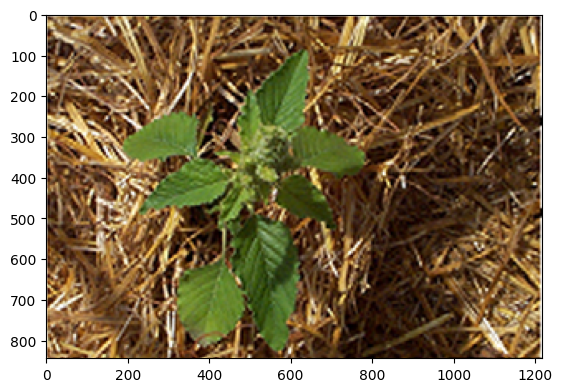

In [16]:
# read images into code
paper = skimage.io.imread('assets/paper.png', plugin='matplotlib')
paper = paper[:, :, 0:3]

# display image
plt.imshow(paper)

In [17]:
exg_p = course.ExG(paper)
exr_p = course.ExR(paper)
ndi_p = course.NDI(paper)

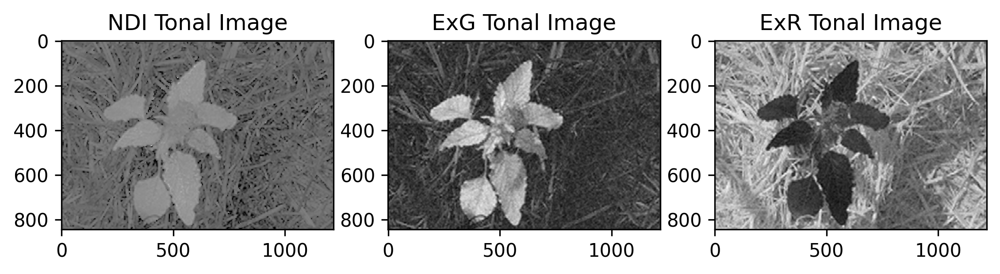

In [18]:
fig, ax = plt.subplots(1, 3, figsize=(9, 3), dpi=300)

ax[0].set_title("NDI Tonal Image")
ax[0].imshow(ndi_p, cmap="gray")

ax[1].set_title("ExG Tonal Image")
ax[1].imshow(exg_p, cmap="gray")

ax[2].set_title("ExR Tonal Image")
ax[2].imshow(exr_p, cmap="gray")

plt.show()

Apply threshold and change to a blank and white 2 class figure

In [19]:
ndi_p_otsu = course.otsu(ndi_p)
exg_p_otsu = course.otsu(exg_p)

ExG_ExR_p = exg_p - exr_p
binary_GR_p = ExG_ExR_p > 0

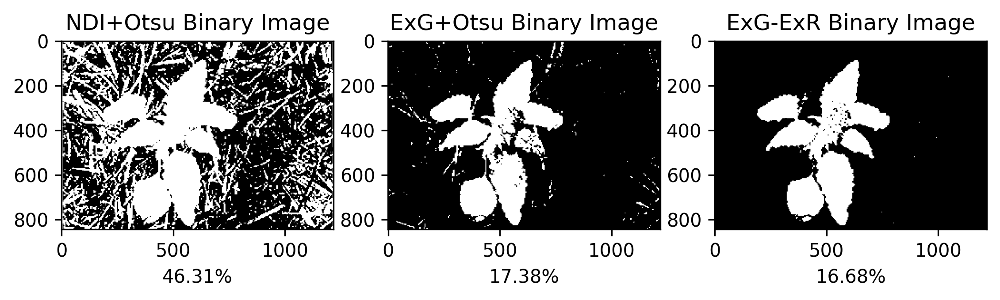

In [20]:
fig, ax = plt.subplots(1, 3, figsize=(9, 3), dpi=300)

ax[0].set_title("NDI+Otsu Binary Image")
ax[0].imshow(ndi_p_otsu, cmap="gray")
ax[0].set_xlabel(f"{round(course.coverage(ndi_p_otsu)*100, 2)}%")

ax[1].set_title("ExG+Otsu Binary Image")
ax[1].imshow(exg_p_otsu, cmap="gray")
ax[1].set_xlabel(f"{round(course.coverage(exg_p_otsu)*100, 2)}%")

ax[2].set_title("ExG-ExR Binary Image")
ax[2].imshow(binary_GR_p, cmap="gray")
ax[2].set_xlabel(f"{round(course.coverage(binary_GR_p)*100, 2)}%")

plt.show()

### Practice on maize point cloud

There is a slightly difference between image color information and point cloud color information:

1. the image color ranges often from \[0, 255\]    
  the point cloud color ranges from \[0, 1\]     
  but they can be converted simplely by `*255` or `/255`
2. image matrix is (x, y, rgb), so you need access one pixel color by `paper[x, y, :]`.   
  the point cloud matrix is (n, rgb), so you access one point color by `pcd_color[n, :]`

In [21]:
print(
    "image matrix shape\n", paper.shape,
    "\n\none image color:\n", paper[0,0,:]
)

image matrix shape
 (844, 1218, 3) 

one image color:
 [1.         1.         0.99607843]


In [22]:
pcd_color = np.asarray(pcd.colors)
print(
    "point cloud matrix shape\n", pcd_color.shape,
    "\n\none pixel color:\n", pcd_color[0,:]
)

point cloud matrix shape
 (296104, 3) 

one pixel color:
 [0.54509804 0.60784314 0.41960784]


According to the image, seems ExG-ExR has the best results for green colors. Use it directly for the maize point cloud

In [23]:
exg_pcd = course.ExG(pcd_color)
exr_pcd = course.ExR(pcd_color)

In [24]:
ExG_ExR_pcd = exg_pcd - exr_pcd
Ex_idx = np.where(ExG_ExR_pcd > 0)[0]

Then we can check the index of selected points

In [25]:
Ex_idx

array([     0,      1,      2, ..., 296100, 296102, 296103])

Paint color on temporary point cloud for visualization

In [26]:
temp_pcd = deepcopy(pcd)

t_color = np.asarray(temp_pcd.colors)

t_color[:, :] = [0, 0, 1]
t_color[Ex_idx,:] = [1, 0, 0]

temp_pcd.colors = o3d.utility.Vector3dVector(t_color)

temp_pcd_down = temp_pcd.uniform_down_sample(10)
course.draw_geometries([temp_pcd_down])

Check results in color:

In [27]:
ex_pcd = pcd.select_by_index(Ex_idx)
ex_pcd_down = ex_pcd.uniform_down_sample(3)

course.draw_geometries([ex_pcd_down])

It also get done but with some noise points. Before introducing the **denoise** step. Let's learning an advanced method doing the same thing, supervised machine learning.

## Trial 3: By color and supervised machine learning

Here we have an image that used for 3D reconstruction:

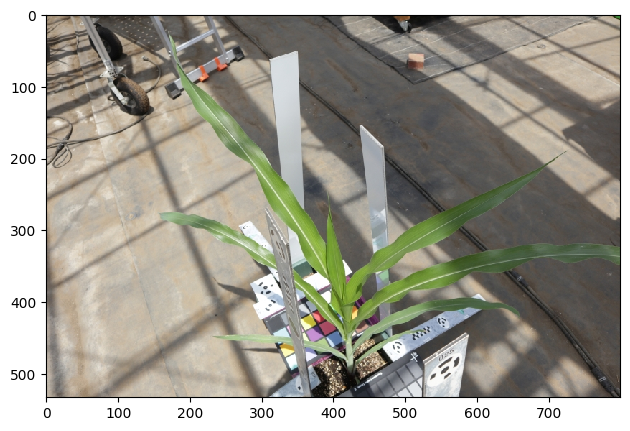

In [28]:
maize_img = skimage.io.imread("./assets/IMG_2637.JPG")
skimage.io.imshow(maize_img)

### Annotate training data

Then, you can using the following tool, to prepare the foreground and background training data.

1. Download the image file to your local machine

    <img src="https://drive.google.com/uc?id=1tGH85g7U0UqwNu4XR9GzohIDvCaTAR3e" alt="Google Drive Image" />

2. Run the following code, and drop the downloaded image file:

    <img src="https://drive.google.com/uc?id=1UVscGa8MZJ4y7Q2yMPkwNrTJVzE8cMpg" alt="Google Drive Image" />


3. Draw the foreground and background respectively

   <img src="https://drive.google.com/uc?id=1_GnmkZfdMLJGBWy3HgfihH5VSiKUv3Cw" alt="Google Drive Image" />


4. Save the result `tranData_2class.csv` to local disk, and then upload to the colab files.

    <img src="https://drive.google.com/uc?id=15vIh5U_xMWTRFX7X1tPoVuG-KV5eGe_E" alt="Google Drive Image" />

    We already provide a prelabeled file, you can use this directly, or upload your own csv file.

In [29]:
%%html
<script src="https://cdn.jsdelivr.net/npm/jquery@3.2.1/dist/jquery.min.js"></script>
<script src="/nbextensions/google.colab/collectTrainJS_v2/color.js"></script>
<link type="text/css" href="/nbextensions/google.colab/collectTrainJS_v2/base.css" rel="stylesheet" />
<script type="text/javascript" src="/nbextensions/google.colab/collectTrainJS_v2/filePicker.js"></script>
<script type="text/javascript" src="/nbextensions/google.colab/collectTrainJS_v2/trainingData.js"></script>

<!-- <canvas id="renderCanvas" touch-action="none" width="1280px" height="720px">
</canvas> -->
<h6>Rerun to refresh. Left click to drag, right click to draw, scroll to zoom, click the classes to change annotations.</h6>
<div id="files"></div>
<div id="classes"></div>
<div id="canvasArea" height="720px"></div>
<div id="control"></div>
<!-- <canvas id="renderCanvas" touch-action="none" width="1280px" height="720px" style="z-index=-1"></canvas>  -->

<script>
    google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);
</script>

### load training data to colab

Then using the following code to read the training data and train model:

In [30]:
train_csv = "assets/trainData_2classes.csv"

train_data, train_kind = course.training_data_from_easypcc_csv(train_csv)

### train model

In [31]:
model = course.train_model(train_data, train_kind, classifier="CART")

|-- Training model time cost=0s


In [32]:
model

DecisionTreeClassifier(max_depth=20)

### apply model

In [33]:
temp_pcd = deepcopy(pcd)
t_color = np.asarray(temp_pcd.colors)

In [34]:
t_color = (t_color * 255).astype(np.uint8)
t_color

array([[139, 155, 107],
       [116, 140,  89],
       [142, 158, 111],
       ...,
       [134, 140, 126],
       [ 48,  61,  33],
       [ 61,  68,  39]], dtype=uint8)

In [35]:
result = course.apply_model(t_color, model)

|==================================================>|100.0%| Cost=0s


The result only contains 0 and 1.

In [36]:
result

array([1., 1., 1., ..., 1., 1., 1.])

In [37]:
np.unique(result)

array([0., 1.])

But we need to convert to index of point cloud

In [38]:
ml_idx = np.where(result == 1.)[0]
ml_idx

array([     0,      1,      2, ..., 296101, 296102, 296103])

Visualize as before

In [39]:
t_color[:, :] = [0, 0, 1]
t_color[ml_idx,:] = [1, 0, 0]

temp_pcd.colors = o3d.utility.Vector3dVector(t_color)

temp_pcd_down = temp_pcd.uniform_down_sample(10)
course.draw_geometries([temp_pcd_down])

And check the colored results

In [40]:
ml_pcd = pcd.select_by_index(ml_idx)
ml_pcd_down = ml_pcd.uniform_down_sample(3)

course.draw_geometries([ml_pcd_down])

# Denoise

Though most of the maize plant have been extracted, but there are several unwanted noises with similar color. Here we can use some techniques to remove these noises.


1. Use height as threshold to remove gorund
2. Use open3d api to remove noise by `remove_radius_outlier`


`radius_outlier_removal` removes points that have few neighbors in a given sphere around them. Two parameters can be used to tune the filter to your data:

* `nb_points`, which lets you pick the minimum amount of points that the sphere should contain.

* `radius`, which defines the radius of the sphere that will be used for counting the neighbors.

> http://www.open3d.org/docs/0.12.0/tutorial/geometry/pointcloud_outlier_removal.html#Radius-outlier-removal

## height filter

Use `ml_pcd` from previous step

In [41]:
ml_pcd_points = np.asarray(ml_pcd.points)

ht_idx = np.where(ml_pcd_points[:,2] > 0.27)[0]   # z > 0.27
ht_idx

array([    0,     1,     2, ..., 93678, 93679, 93680])

In [42]:
ml_pcd_ht = ml_pcd.select_by_index(ht_idx)
ml_pcd_ht_down = ml_pcd_ht.uniform_down_sample(3)

course.draw_geometries([ml_pcd_ht_down])

## outlier filter

The following code means:

Check each point in the point cloud, if its 0.01m sphere contains less than 25 points, this point is marked as the noise point.

In [43]:
ml_rm_pcd, ml_rm_pcd_idx = ml_pcd_ht.remove_radius_outlier(
    25, 0.01, print_progress=True)

Check which points (blue) are removed

In [44]:
temp_pcd = deepcopy(ml_pcd_ht)

t_color = np.asarray(temp_pcd.colors)

t_color[:, :] = [0, 0, 1]
t_color[ml_rm_pcd_idx,:] = [1, 0, 0]

temp_pcd.colors = o3d.utility.Vector3dVector(t_color)

temp_pcd_down = temp_pcd.uniform_down_sample(3)
course.draw_geometries([temp_pcd_down])

See the final colored result

In [45]:
ml_rm_pcd_down = ml_rm_pcd.uniform_down_sample(2)

course.draw_geometries([ml_rm_pcd_down])